# Räumliche Autokorrelation

Moran's I am Beispiel von [Daten aus dem Deutschlandatlas](https://www.deutschlandatlas.bund.de/DE/Service/Downloads/Deutschlandatlas-Daten.html) (Erläuterungen gibt's [hier](https://www.deutschlandatlas.bund.de/DE/Service/Downloads/Indikatoren_Deutschlandatlas.html)).

In [1]:
import pandas as pd
import geopandas as gpd
import os.path
import requests
import zipfile
import seaborn as sns
import matplotlib.pyplot as plt
from pysal.explore import esda

/opt/conda/lib/python3.12/site-packages/spaghetti/network.py:41: FutureWarning: The next major release of pysal/spaghetti (2.0.0) will drop support for all ``libpysal.cg`` geometries. This change is a first step in refactoring ``spaghetti`` that is expected to result in dramatically reduced runtimes for network instantiation and operations. Users currently requiring network and point pattern input as ``libpysal.cg`` geometries should prepare for this simply by converting to ``shapely`` geometries.
  warnings.warn(dep_msg, FutureWarning, stacklevel=1)


Die Warnung ignorieren wir ;) Klappt auch so.

Download der Deutschlandatlasdaten, falls sie noch nicht vorliegen:

In [2]:
file = "atlas.xslx"
url="https://www.deutschlandatlas.bund.de/DE/Service/Downloads/Deutschlandatlas-Daten.xlsx?__blob=publicationFile&v=40"
if not os.path.isfile(file):    
    response = requests.get(url)    
    with open(file, mode="wb") as file:
        file.write(response.content)
    print("Download von", file, "fertig.")
else:
    print(file, "lag schon vor.")

atlas.xslx lag schon vor.


Aus dieser Exceldatei laden wir das Tabellenblatt mit den Daten auf Kreisebene für Dezember 2021:

In [3]:
tabelle = pd.read_excel("atlas.xslx", sheet_name="Deutschlandatlas_KRS1221")
tabelle

,KRS1221,Kreisname,fl_suv,fl_landw,fl_wald,bev_binw,bev_ausw,ko_kasskred,wahl_beteil,bev_u18,...,pfl_stat,pfl_geld,kbtr_pers,schule_oabschl,kbetr_u3,kbetr_ue3,kbetr_ue6,kinder_bg,straft,einbr
0,1001000,"Flensburg, Stadt",53.36,22.33,6.72,15.69,144.66,76.83,74.0,15.87,...,19.1,40.0,6.14,8.81,35.14,89.89,26.48,22.63,10620.88,172.31
1,1002000,"Kiel, Landeshauptstadt",58.52,24.03,6.78,-33.02,34.64,0.00,76.2,14.80,...,16.4,40.4,6.54,8.48,36.56,90.64,23.71,24.33,9603.12,97.46
2,1003000,"Lübeck, Hansestadt",37.73,30.31,15.48,46.38,24.00,624.20,72.4,15.08,...,24.9,43.1,6.10,8.28,37.42,90.08,15.78,20.64,10153.18,92.01
3,1004000,"Neumünster, Stadt",51.76,37.79,4.65,-146.30,134.22,138.82,67.9,16.49,...,23.8,42.4,5.83,7.36,29.93,82.89,19.44,20.29,15947.97,137.11
4,1051000,Dithmarschen,11.23,75.28,3.82,84.87,28.22,0.00,76.0,15.59,...,18.3,43.4,6.60,9.55,24.16,83.52,13.74,14.26,5347.51,64.94
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
395,16073000,Saalfeld-Rudolstadt,10.28,33.12,54.93,26.64,2.97,11.34,73.5,14.14,...,13.6,50.0,8.17,11.57,59.62,100.78,13.80,7.72,5157.03,31.69
396,16074000,Saale-Holzland-Kreis,10.83,50.18,37.87,24.00,22.06,49.97,78.4,15.57,...,13.5,55.3,7.40,6.10,61.07,91.08,11.84,4.57,5523.98,25.45
397,16075000,Saale-Orla-Kreis,8.91,47.04,41.04,21.51,16.96,9.92,76.4,15.10,...,11.4,50.6,7.72,8.56,55.36,96.62,12.64,6.97,5700.37,40.49
398,16076000,Greiz,12.75,58.25,26.77,35.07,26.95,0.00,76.4,14.53,...,17.0,44.4,7.77,7.38,61.58,97.47,14.35,5.98,4688.77,7.28


Nun laden wir die Geometrien der [Landkreise vom BKG](https://gdz.bkg.bund.de/index.php/default/digitale-geodaten/verwaltungsgebiete/verwaltungsgebiete-1-250-000-stand-01-01-vg250-01-01.html) herunter:

In [4]:
file = "Verwaltungsgebiete.zip"
url="https://daten.gdz.bkg.bund.de/produkte/vg/vg250_ebenen_0101/aktuell/vg250_01-01.utm32s.shape.ebenen.zip"

if not os.path.isfile(file):    
    response = requests.get(url)    
    with open(file, mode="wb") as file:
        file.write(response.content)
    print("Download von", file, "fertig.")
else:
    print(file, "lag schon vor.")

Verwaltungsgebiete.zip lag schon vor.


Entzippen:

In [5]:
with zipfile.ZipFile(file,"r") as zip_ref:
    zip_ref.extractall()

In [6]:
kreise = gpd.read_file("vg250_01-01.utm32s.shape.ebenen/vg250_ebenen_0101/VG250_KRS.shp")
kreise

,OBJID,BEGINN,ADE,GF,BSG,ARS,AGS,SDV_ARS,GEN,BEZ,...,SN_V1,SN_V2,SN_G,FK_S3,NUTS,ARS_0,AGS_0,WSK,DLM_ID,geometry
0,DEBKGVG200000C75,2022-12-20,4,4,1,01001,01001,010010000000,Flensburg,Kreisfreie Stadt,...,00,00,000,R,DEF01,010010000000,01001000,2008-01-01,DEBKGDL20000002R,"POLYGON ((526513.753 6075133.412, 526547.941 6..."
1,DEBKGVG200000C76,2022-12-20,4,4,1,01002,01002,010020000000,Kiel,Kreisfreie Stadt,...,00,00,000,R,DEF02,010020000000,01002000,2006-01-01,DEBKGDL20000E43X,"POLYGON ((575841.569 6032148.032, 575869.668 6..."
2,DEBKGVG200000C77,2022-12-20,4,4,1,01003,01003,010030000000,Lübeck,Kreisfreie Stadt,...,00,00,000,R,DEF03,010030000000,01003000,2006-02-01,DEBKGDL20000DYM9,"POLYGON ((623056.151 5983746.445, 623191.574 5..."
3,DEBKGVG200000C78,2022-12-20,4,4,1,01004,01004,010040000000,Neumünster,Kreisfreie Stadt,...,00,00,000,R,DEF04,010040000000,01004000,1970-04-26,DEBKGDL20000E4KX,"POLYGON ((565015.652 6000637.513, 565128.417 6..."
4,DEBKGVG200000C79,2023-04-26,4,4,1,01051,01051,010510044044,Dithmarschen,Kreis,...,00,00,000,R,DEF05,010510000000,01051000,2011-08-01,DEBKGDL20000E14G,"MULTIPOLYGON (((479673.017 5990236.379, 479747..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
425,DEBKGVG200000CIY,2022-12-20,4,2,1,13003,13003,130030000000,Rostock,Kreisfreie Stadt,...,00,00,000,R,DE803,130030000000,13003000,2007-01-01,DEBKGDL20000003J,"MULTIPOLYGON (((702548.55 6008003.333, 702472...."
426,DEBKGVG200000CIZ,2015-06-18,4,2,1,13072,13072,130720043043,Rostock,Landkreis,...,00,00,000,R,DE80K,130720000000,13072000,2011-09-04,DEBKGDL20000SRLP,"POLYGON ((670304.689 5998099.8, 670399.796 599..."
427,DEBKGVG200000CJ0,2022-12-20,4,2,1,13073,13073,130730088088,Vorpommern-Rügen,Landkreis,...,00,00,000,R,DE80L,130730000000,13073000,2011-09-04,DEBKGDL20000QGFU,"MULTIPOLYGON (((728316.348 6041738.751, 728273..."
428,DEBKGVG200000CJ1,2020-08-27,4,2,1,13074,13074,130740087087,Nordwestmecklenburg,Landkreis,...,00,00,000,R,DE80M,130740000000,13074000,2011-09-04,DEBKGDL20000QGFR,"MULTIPOLYGON (((654143.674 5980166.468, 654000..."


In [7]:
kreise.explore()

Beide Tabellen können über die beiden Felder ```tabelle.KRS1221``` bzw. ```kreise.AGS_0``` verknüpft werden, allerdings enthält letzteres eine führende 0, ersteres nicht. Daher bauen wir mittels [zfill](https://pandas.pydata.org/docs/reference/api/pandas.Series.str.zfill.html) zunächst die führende 0 ein:

In [8]:
tabelle["KRS1221"] = tabelle["KRS1221"].astype(str) # Spalte in Strings konvertieren
tabelle["KRS1221"] = tabelle["KRS1221"].str.zfill(8)
tabelle

,KRS1221,Kreisname,fl_suv,fl_landw,fl_wald,bev_binw,bev_ausw,ko_kasskred,wahl_beteil,bev_u18,...,pfl_stat,pfl_geld,kbtr_pers,schule_oabschl,kbetr_u3,kbetr_ue3,kbetr_ue6,kinder_bg,straft,einbr
0,01001000,"Flensburg, Stadt",53.36,22.33,6.72,15.69,144.66,76.83,74.0,15.87,...,19.1,40.0,6.14,8.81,35.14,89.89,26.48,22.63,10620.88,172.31
1,01002000,"Kiel, Landeshauptstadt",58.52,24.03,6.78,-33.02,34.64,0.00,76.2,14.80,...,16.4,40.4,6.54,8.48,36.56,90.64,23.71,24.33,9603.12,97.46
2,01003000,"Lübeck, Hansestadt",37.73,30.31,15.48,46.38,24.00,624.20,72.4,15.08,...,24.9,43.1,6.10,8.28,37.42,90.08,15.78,20.64,10153.18,92.01
3,01004000,"Neumünster, Stadt",51.76,37.79,4.65,-146.30,134.22,138.82,67.9,16.49,...,23.8,42.4,5.83,7.36,29.93,82.89,19.44,20.29,15947.97,137.11
4,01051000,Dithmarschen,11.23,75.28,3.82,84.87,28.22,0.00,76.0,15.59,...,18.3,43.4,6.60,9.55,24.16,83.52,13.74,14.26,5347.51,64.94
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
395,16073000,Saalfeld-Rudolstadt,10.28,33.12,54.93,26.64,2.97,11.34,73.5,14.14,...,13.6,50.0,8.17,11.57,59.62,100.78,13.80,7.72,5157.03,31.69
396,16074000,Saale-Holzland-Kreis,10.83,50.18,37.87,24.00,22.06,49.97,78.4,15.57,...,13.5,55.3,7.40,6.10,61.07,91.08,11.84,4.57,5523.98,25.45
397,16075000,Saale-Orla-Kreis,8.91,47.04,41.04,21.51,16.96,9.92,76.4,15.10,...,11.4,50.6,7.72,8.56,55.36,96.62,12.64,6.97,5700.37,40.49
398,16076000,Greiz,12.75,58.25,26.77,35.07,26.95,0.00,76.4,14.53,...,17.0,44.4,7.77,7.38,61.58,97.47,14.35,5.98,4688.77,7.28


Checken, ob es für alle Kreise genau einen Match gibt:

In [9]:
for kreis in tabelle["KRS1221"]:
    if len(kreise[kreise["AGS_0"] == kreis]) != 1: # sucht die IDs, für die es nicht genau einen Match gibt
        print(kreis)

01001000
01002000
01051000
01054000
01055000
01056000
01057000
01058000
01059000
01061000
02000000
03352000
03359000
03402000
03405000
03452000
03455000
03457000
03462000
04011000
04012000
08335000
13003000
13072000
13073000
13074000
13075000


Warum gibt es da nicht nur einen Treffer? Schauen wir uns das erste Beispiel an:

In [10]:
kreise[kreise["AGS_0"] == "01001000"].explore()

Einziger Unterschied scheint das Feld ```GF``` zu sein. Laut [Dokumentation](vg250_01-01.utm32s.shape.ebenen/dokumentation/verwaltungsgliederung_vg.pdf) (S.21) irgendwas mit dem Teil, der im Wasser liegt. Passt das für die anderen auch?

In [11]:
kreise[kreise["GF"] == 2].explore()

Sieht gut aus. Wieviele sind das?

In [12]:
print(len(kreise))
print(len(kreise[kreise["GF"] == 2]))
print(len(kreise[kreise["GF"] == 4]))

430
30
400


Bingo! Dann also der Join:

In [13]:
kreise = pd.merge(left = kreise[kreise["GF"] == 4], right = tabelle, left_on = "AGS_0", right_on = "KRS1221")
kreise.head()

,OBJID,BEGINN,ADE,GF,BSG,ARS,AGS,SDV_ARS,GEN,BEZ,...,pfl_stat,pfl_geld,kbtr_pers,schule_oabschl,kbetr_u3,kbetr_ue3,kbetr_ue6,kinder_bg,straft,einbr
0,DEBKGVG200000C75,2022-12-20,4,4,1,01001,01001,010010000000,Flensburg,Kreisfreie Stadt,...,19.1,40.0,6.14,8.81,35.14,89.89,26.48,22.63,10620.88,172.31
1,DEBKGVG200000C76,2022-12-20,4,4,1,01002,01002,010020000000,Kiel,Kreisfreie Stadt,...,16.4,40.4,6.54,8.48,36.56,90.64,23.71,24.33,9603.12,97.46
2,DEBKGVG200000C77,2022-12-20,4,4,1,01003,01003,010030000000,Lübeck,Kreisfreie Stadt,...,24.9,43.1,6.10,8.28,37.42,90.08,15.78,20.64,10153.18,92.01
3,DEBKGVG200000C78,2022-12-20,4,4,1,01004,01004,010040000000,Neumünster,Kreisfreie Stadt,...,23.8,42.4,5.83,7.36,29.93,82.89,19.44,20.29,15947.97,137.11
4,DEBKGVG200000C79,2023-04-26,4,4,1,01051,01051,010510044044,Dithmarschen,Kreis,...,18.3,43.4,6.60,9.55,24.16,83.52,13.74,14.26,5347.51,64.94


Schauen wir uns noch mal alle Spalten an:

In [14]:
from IPython.display import display
pd.options.display.max_columns = None
display(kreise)

,OBJID,BEGINN,ADE,GF,BSG,ARS,AGS,SDV_ARS,GEN,BEZ,IBZ,BEM,NBD,SN_L,SN_R,SN_K,SN_V1,SN_V2,SN_G,FK_S3,NUTS,ARS_0,AGS_0,WSK,DLM_ID,geometry,KRS1221,Kreisname,fl_suv,fl_landw,fl_wald,bev_binw,bev_ausw,ko_kasskred,wahl_beteil,bev_u18,bev_18_65,bev_ue65,bev_ausl,preis_miet,wohn_EZFH,wohn_MFH,preis_baul,heiz_wohn,erw_bip,hh_veink,bquali_unifh,bquali_mabschl,bquali_oabschl,erw_wachs,erw_mini,erw_minineben,alq,elterng_v,grusi,sozsich,elade,eauto,pfl_ambu,pfl_stat,pfl_geld,kbtr_pers,schule_oabschl,kbetr_u3,kbetr_ue3,kbetr_ue6,kinder_bg,straft,einbr
0,DEBKGVG200000C75,2022-12-20,4,4,1,01001,01001,010010000000,Flensburg,Kreisfreie Stadt,40,--,ja,01,0,01,00,00,000,R,DEF01,010010000000,01001000,2008-01-01,DEBKGDL20000002R,"POLYGON ((526513.753 6075133.412, 526547.941 6...",01001000,"Flensburg, Stadt",53.36,22.33,6.72,15.69,144.66,76.83,74.0,15.87,63.95,20.19,16.99,"7,00 bis unter 8,50",2.4,31.4,100 bis unter 200,0.33,65.27,20.15,15.55,62.44,14.18,0.83,10.46,5.63,7.7,27.79,6.88,14.92,181.52,2.36,27.6,19.1,40.0,6.14,8.81,35.14,89.89,26.48,22.63,10620.88,172.31
1,DEBKGVG200000C76,2022-12-20,4,4,1,01002,01002,010020000000,Kiel,Kreisfreie Stadt,40,--,ja,01,0,02,00,00,000,R,DEF02,010020000000,01002000,2006-01-01,DEBKGDL20000E43X,"POLYGON ((575841.569 6032148.032, 575869.668 6...",01002000,"Kiel, Landeshauptstadt",58.52,24.03,6.78,-33.02,34.64,0.00,76.2,14.80,66.18,19.02,12.50,"8,50 bis unter 10,00",2.0,21.0,200 bis unter 300,7.92,70.75,21.34,21.61,58.24,12.27,0.97,9.59,5.03,7.4,38.76,6.60,14.67,166.72,2.15,29.5,16.4,40.4,6.54,8.48,36.56,90.64,23.71,24.33,9603.12,97.46
2,DEBKGVG200000C77,2022-12-20,4,4,1,01003,01003,010030000000,Lübeck,Kreisfreie Stadt,40,--,ja,01,0,03,00,00,000,R,DEF03,010030000000,01003000,2006-02-01,DEBKGDL20000DYM9,"POLYGON ((623056.151 5983746.445, 623191.574 5...",01003000,"Lübeck, Hansestadt",37.73,30.31,15.48,46.38,24.00,624.20,72.4,15.08,61.37,23.55,11.21,"10,00 bis unter 11,50",9.0,32.1,500 und mehr,24.88,76.90,22.40,14.48,63.18,13.31,0.67,8.63,5.83,7.6,41.10,6.28,13.41,70.61,1.76,18.3,24.9,43.1,6.10,8.28,37.42,90.08,15.78,20.64,10153.18,92.01
3,DEBKGVG200000C78,2022-12-20,4,4,1,01004,01004,010040000000,Neumünster,Kreisfreie Stadt,40,--,ja,01,0,04,00,00,000,R,DEF04,010040000000,01004000,1970-04-26,DEBKGDL20000E4KX,"POLYGON ((565015.652 6000637.513, 565128.417 6...",01004000,"Neumünster, Stadt",51.76,37.79,4.65,-146.30,134.22,138.82,67.9,16.49,60.45,23.06,13.51,"7,00 bis unter 8,50",8.3,15.9,100 bis unter 200,7.25,70.62,21.22,9.87,65.51,14.41,1.40,8.77,5.48,7.8,25.79,4.91,15.29,222.64,2.42,20.5,23.8,42.4,5.83,7.36,29.93,82.89,19.44,20.29,15947.97,137.11
4,DEBKGVG200000C79,2023-04-26,4,4,1,01051,01051,010510044044,Dithmarschen,Kreis,42,--,ja,01,0,51,00,00,000,R,DEF05,010510000000,01051000,2011-08-01,DEBKGDL20000E14G,"MULTIPOLYGON (((479673.017 5990236.379, 479747...",01051000,Dithmarschen,11.23,75.28,3.82,84.87,28.22,0.00,76.0,15.59,58.94,25.47,6.55,"7,00 bis unter 8,50",26.7,25.3,50 bis unter 100,36.99,81.26,24.62,8.26,69.09,12.92,0.96,12.20,7.18,5.5,25.10,2.46,8.77,198.15,1.91,23.7,18.3,43.4,6.60,9.55,24.16,83.52,13.74,14.26,5347.51,64.94
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
395,DEBKGVG200000CI4,2022-12-20,4,4,1,16073,16073,160730077077,Saalfeld-Rudolstadt,Landkreis,43,--,ja,16,0,73,00,00,000,R,DEG0I,160730000000,16073000,2019-01-01,DEBKGDL20000E6O4,"POLYGON ((659352.786 5633725.523, 659501.633 5...",16073000,Saalfeld-Rudolstadt,10.28,33.12,54.93,26.64,2.97,11.34,73.5,14.14,55.60,30.26,3.09,"5,50 bis unter 7,00",5.9,4.8,bis unter 50,25.69,66.16,22.81,11.77,76.29,7.40,-1.04,6.93,3.84,5.5,55.54,0.61,5.52,92.62,0.98,25.6,13.6,50.0,8.17,11.57,59.62,100.78,13.80,7.72,5157.03,31.69
396,DEBKGVG200000CI5,2022-12-20,4,4,1,16074,16074,160745052018,Saale-Holzland-Kreis,Landkreis,43,--,nein,16,0

Chroplethenkarten eins Beispielattributes, hier den *Anteil sozialversicherungspflichtig Beschäftigter am Arbeitsort mit einem akademischen Abschluss an allen sozialversicherungspflichtig Beschäftigten im Jahr 2021 in %*:

In [15]:
kreise.explore("bquali_unifh")

An diesem Beispiel schauen wir uns einmal die räumliche Autokorrelation an. Es sieht in der Karte so aus, als hätten benachbarte Kreise häufig recht ähnliche Werte. Das wollen wir messen mittels…

# [Moran's I](https://pro.arcgis.com/de/pro-app/latest/tool-reference/spatial-statistics/h-how-spatial-autocorrelation-moran-s-i-spatial-st.htm)

In [16]:
from pysal.lib import weights

Dafür müssen wir die

### Spatial Weights Matrix

erstellen. Dazu finden wir für jeden Kreis alle Nachbarn; dann nehmen wir die einfachste Variante, das heißt die Nachbarn bekommen das Gewicht 1, alle anderen 0:

In [17]:
w = weights.Queen.from_dataframe(kreise, ids='OBJID')

Das Objekt ```w``` kennt jetzt zu jedem Kreis die Nachbarn; hier zum beispeil für Bochum:

In [18]:
kreise[kreise["Kreisname"] == "Bochum, Stadt"]["OBJID"]

104    DEBKGVG200000CA1
Name: OBJID, dtype: object

In [19]:
w["DEBKGVG200000CA1"]

{'DEBKGVG200000CA6': 1.0,
 'DEBKGVG200000C8Y': 1.0,
 'DEBKGVG200000C9R': 1.0,
 'DEBKGVG200000C9N': 1.0,
 'DEBKGVG200000CA2': 1.0,
 'DEBKGVG200000CA5': 1.0}

Welche Städte verbergen sich hinter den IDs?

In [20]:
for k in w["DEBKGVG200000CA1"]:
    print(kreise[kreise["OBJID"] == k]["GEN"])

109    Ennepe-Ruhr-Kreis
Name: GEN, dtype: object
65    Essen
Name: GEN, dtype: object
94    Recklinghausen
Name: GEN, dtype: object
90    Gelsenkirchen
Name: GEN, dtype: object
105    Dortmund
Name: GEN, dtype: object
108    Herne
Name: GEN, dtype: object


### Standardisierung der Gewichte

Wir verteilen die Gewichte so, dass die Summe der Gewichte für alle Nachbarn 1 ergeben:

In [21]:
w.transform = 'R'

Die Gewichte für Bochum sehen jetzt so aus – je 1/6 für jeden der 6 Nachbarn:

In [22]:
w["DEBKGVG200000CA1"]

{'DEBKGVG200000CA6': 0.16666666666666666,
 'DEBKGVG200000C8Y': 0.16666666666666666,
 'DEBKGVG200000C9R': 0.16666666666666666,
 'DEBKGVG200000C9N': 0.16666666666666666,
 'DEBKGVG200000CA2': 0.16666666666666666,
 'DEBKGVG200000CA5': 0.16666666666666666}

### Spatial Lag

Der sog. [Spatial Lag](https://pysal.org/libpysal/generated/libpysal.weights.lag_spatial.html) ist das Produkt der standardiserten Gewichte und einer Variable – in unserem Fall ```bquali_unifh```, also der *Anteil sozialversicherungspflichtig Beschäftigter am Arbeitsort mit einem akademischen Abschluss an allen sozialversicherungspflichtig Beschäftigten im Jahr 2021 in %*: 

In [23]:
kreise['w_bquali_unifh'] = weights.lag_spatial(w, kreise['bquali_unifh'])
kreise[['OBJID', 'Kreisname', 'bquali_unifh', 'w_bquali_unifh']]

,OBJID,Kreisname,bquali_unifh,w_bquali_unifh
0,DEBKGVG200000C75,"Flensburg, Stadt",15.55,8.440000
1,DEBKGVG200000C76,"Kiel, Landeshauptstadt",21.61,11.255000
2,DEBKGVG200000C77,"Lübeck, Hansestadt",14.48,11.262500
3,DEBKGVG200000C78,"Neumünster, Stadt",9.87,11.810000
4,DEBKGVG200000C79,Dithmarschen,8.26,9.730000
...,...,...,...,...
395,DEBKGVG200000CI4,Saalfeld-Rudolstadt,11.77,10.414286
396,DEBKGVG200000CI5,Saale-Holzland-Kreis,11.55,14.071429
397,DEBKGVG200000CI6,Saale-Orla-Kreis,8.03,10.506667
398,DEBKGVG200000CI7,Greiz,9.69,10.860000


Wir haben jetzt für jeden Kreis nicht nur den Anteil der Beschäftigten mit akademischem Abschluss (```bquali_unifh```), sondern auch den Durchschnittswert der Nachbarn für das gleiche Attribut (```w_bquali_unifh```)! Also für Flensburg: 15.55% der Beschäftigten in Flensburg haben einen akademischen Abschluss, während es in den benachbarten Kreisen im Schnitt nur 8.44% sind. 

Bevor wir den Wert für Moran's I berechnen, erstellen wir zunächst einen

# Moran Plot

Für eine grafische Darstellung dieser Werte ist es sinnvoll, die Werte als [z-Score zu standardisieren](https://de.wikipedia.org/wiki/Standardisierung_(Statistik)):

In [24]:
kreise['bquali_unifh_std'] = (kreise['bquali_unifh'] - kreise['bquali_unifh'].mean()) / kreise['bquali_unifh'].std()

… und davon noch mal den Spatial Lag berechnen:

In [25]:
kreise['w_bquali_unifh_std'] = weights.lag_spatial(w, kreise['bquali_unifh_std'])

Nun können wir den [Moran Plot](https://r-spatial.github.io/spdep/reference/moran.plot.html) erstellen:

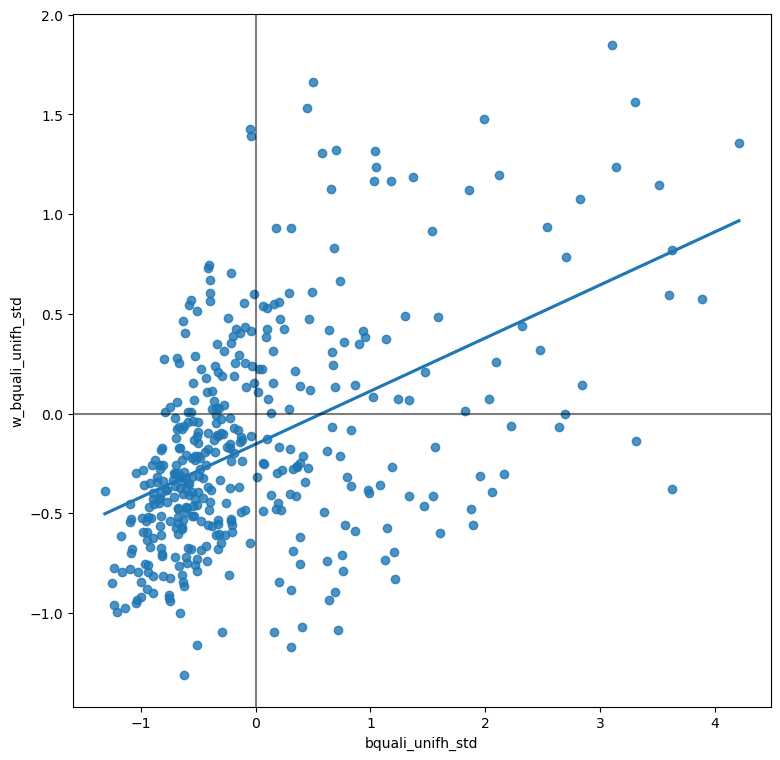

In [26]:
# Setup the figure and axis
f, ax = plt.subplots(1, figsize=(9, 9))
# Plot values
sns.regplot(x='bquali_unifh_std', y='w_bquali_unifh_std', data=kreise, ci=None)
# Add vertical and horizontal lines
plt.axvline(0, c='k', alpha=0.5)
plt.axhline(0, c='k', alpha=0.5)
# Display
plt.show()

Zur Interpretation: Im Quadrant rechts oben sieht man nun die Kreise, die hohe Quoten von Arbeitnehmern mit Hochschulabschluss haben und wo gleichzeitig auch die Nachbarn hohe Quoten haben. Links unten dann analog die Kreise mit einer niedrigen Quote, wo auch die Nachbarn eine niedrige Quote haben. Links oben und rechts unten sind dann die Kreise, die etwas ungewöhnlich sind, weil sie entweder selbst eine hohe Quote haben, die Nachbarn aber eine niedrige (rechts unten) oder umgekehrt (links oben). 

Nun aber zum …

# Moran's I

In [27]:
mi = esda.Moran(kreise['bquali_unifh'], w)
mi.I

np.float64(0.2662647199906184)

Also keine besonders starke räumliche Autokorrelation zwischen den Kreisen. Die Karte suggeriert etwas anderes!

Schauen wir uns noch etwas anderes an:

# Ökologischer Fehlschluss

Welche Variablen könnten auf Kreisebene einen statistischen Zusammenhang zeigen?

In [ ]:
sns.pairplot(kreise, vars=["bquali_unifh", "straft", "einbr", "alq"])

Zwischen der Arbeitslosenquote (```alq```) und der Anzahl der Einbrüche pro 100.000 Einwohner (```einbr```) scheint es einen Zusammenhang zu geben:

In [ ]:
sns.regplot(kreise, x="alq", y="einbr")

Korrelationskoeffizient nach [Pearson](https://de.wikipedia.org/wiki/Korrelationskoeffizient_nach_Bravais-Pearson): 

In [ ]:
from scipy import stats
stats.pearsonr(kreise["alq"], kreise["einbr"])

Also eine statistisch signifikante Korrleation von ca 71%.

Wie sieht das Ergebnis dieser Analyse aus, wenn wir sie auf Länderebene wiederholen? Dazu berechnen wir den Durchschnittswert für die beiden Variablen pro Bundesland (die ID pro Bundesland ist in der Variable ```SN_L``` gespeichert):

In [ ]:
laender = kreise[["SN_L", "einbr", "alq"]].groupby('SN_L').agg('mean')
laender 

In [ ]:
sns.regplot(laender, x="alq", y="einbr")

In [ ]:
stats.pearsonr(laender["alq"], laender["einbr"])

Was sagt das nun aus?